In [1]:
# Imports the libraries and installs if not exists

try:
    import pandas as pd
except ModuleNotFoundError:
    !pip install pandas --user 
    
try:
    import numpy as np
except ModuleNotFoundError:
    !pip install numpy --user  
    
try:
    import matplotlib.pyplot as plt
except ModuleNotFoundError:
    !pip install matplotlib --user 
    
try:
    from sklearn import linear_model
except ModuleNotFoundError:
    !pip install scikit-learn --user 
    


In [2]:
# Settings
plt.rcParams['figure.figsize'] = (20,10)

# load data

In [3]:
DATAPATH = './dataSets/external-debt-indicators-for-sri-lanka-1.csv'
DATAPATH2 = './dataSets/gdp-sri-lanka.csv'


df = pd.read_csv(DATAPATH)
df2 = pd.read_csv(DATAPATH2)

# removes the first row and the first two columns
df = df.iloc[1:, 2:]
df.head(1000)



,Year,Indicator Name,Indicator Code,Value
1,2018,"Imports of goods, services and primary income ...",BM.GSR.TOTL.CD,29502061428.4739
2,2017,"Imports of goods, services and primary income ...",BM.GSR.TOTL.CD,27892795103.2123
3,2016,"Imports of goods, services and primary income ...",BM.GSR.TOTL.CD,25770303382.7371
4,2015,"Imports of goods, services and primary income ...",BM.GSR.TOTL.CD,25146568842.0975
5,2014,"Imports of goods, services and primary income ...",BM.GSR.TOTL.CD,25104952770.5926
...,...,...,...,...
996,1984,"IBRD loans and IDA credits (DOD, current US$)",DT.DOD.MWBG.CD,361793197.5
997,1983,"IBRD loans and IDA credits (DOD, current US$)",DT.DOD.MWBG.CD,280544438.3
998,1982,"IBRD loans and IDA credits (DOD, current US$)",DT.DOD.MWBG.CD,210663357.5
999,1981,"IBRD loans and IDA credits (DOD, current US$)",DT.DOD.MWBG.CD,154537474.4


# Plot Graphs for existing data

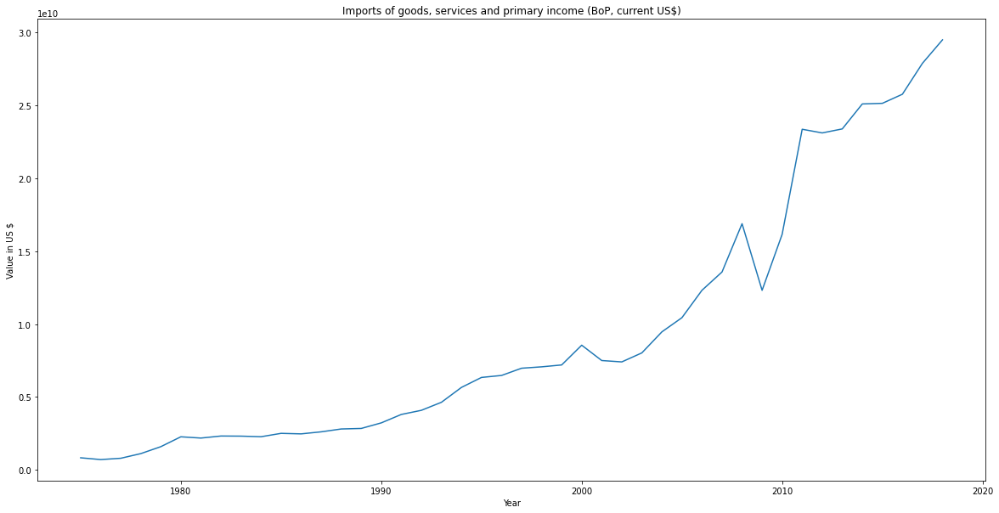

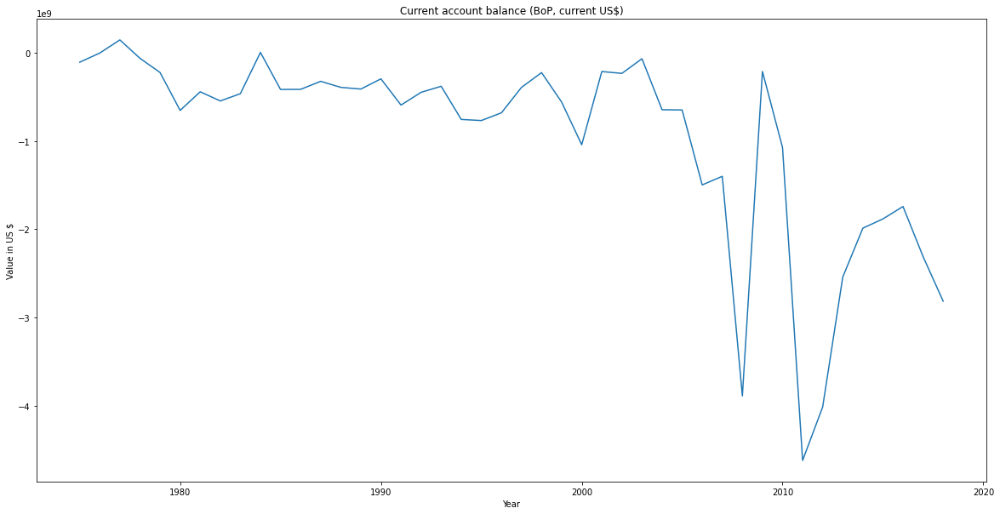

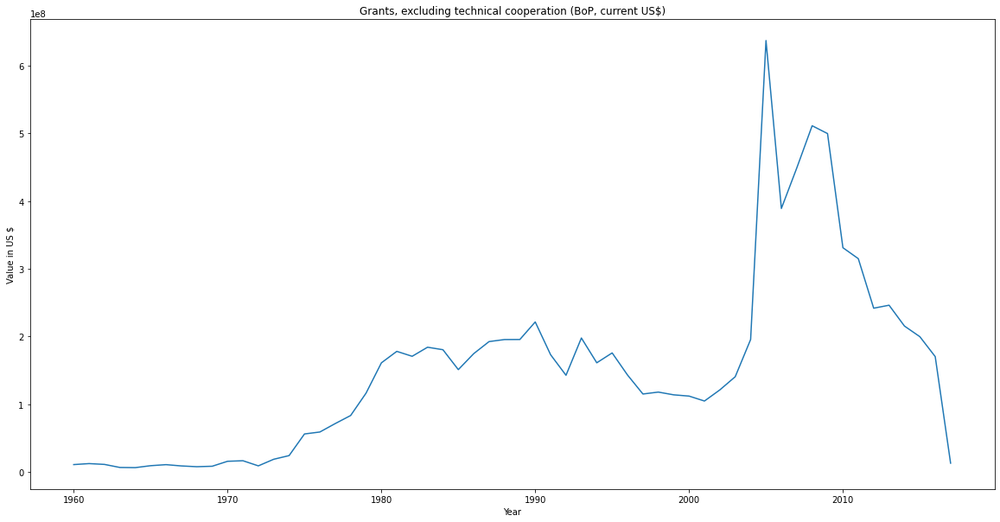

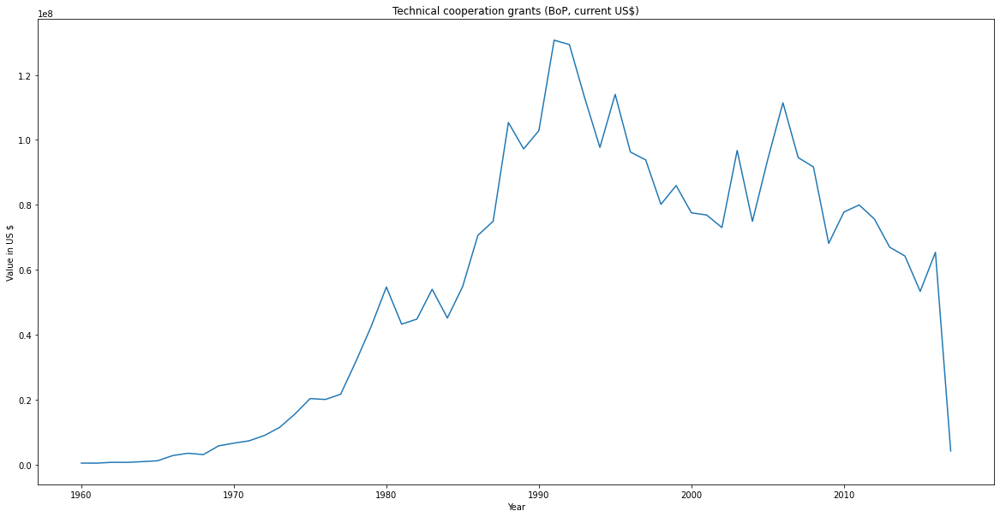

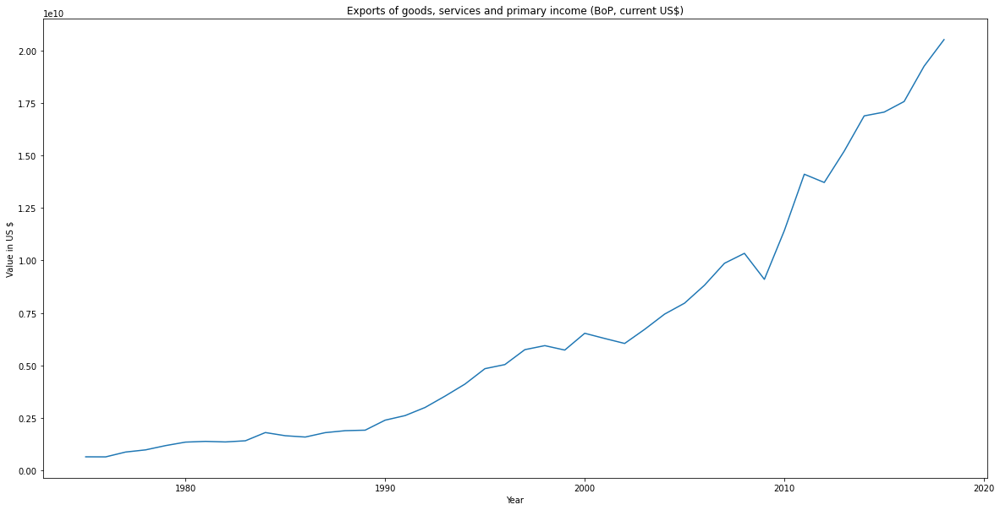

...

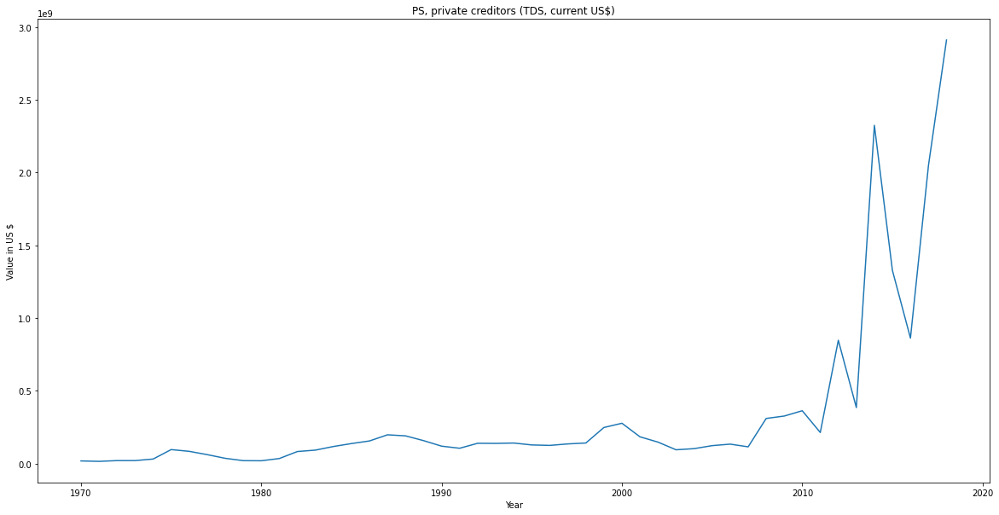

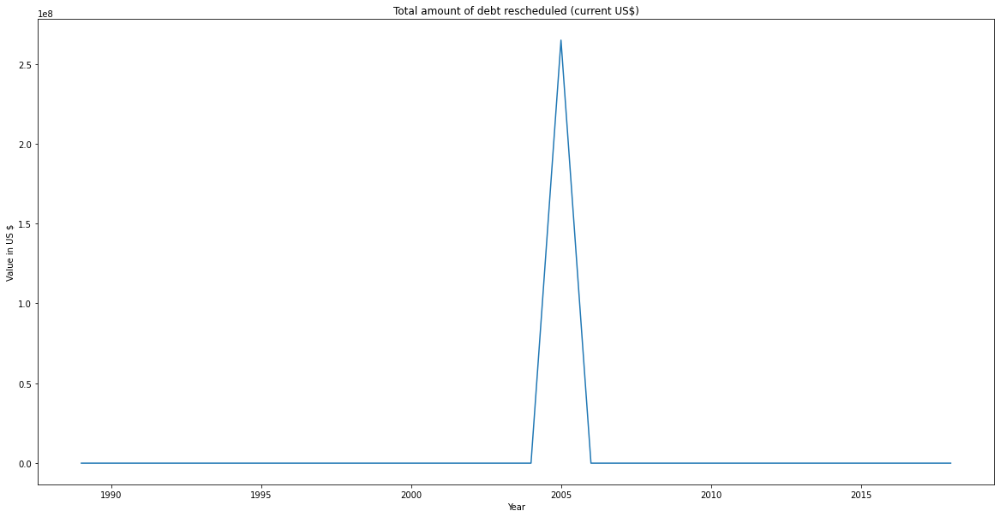

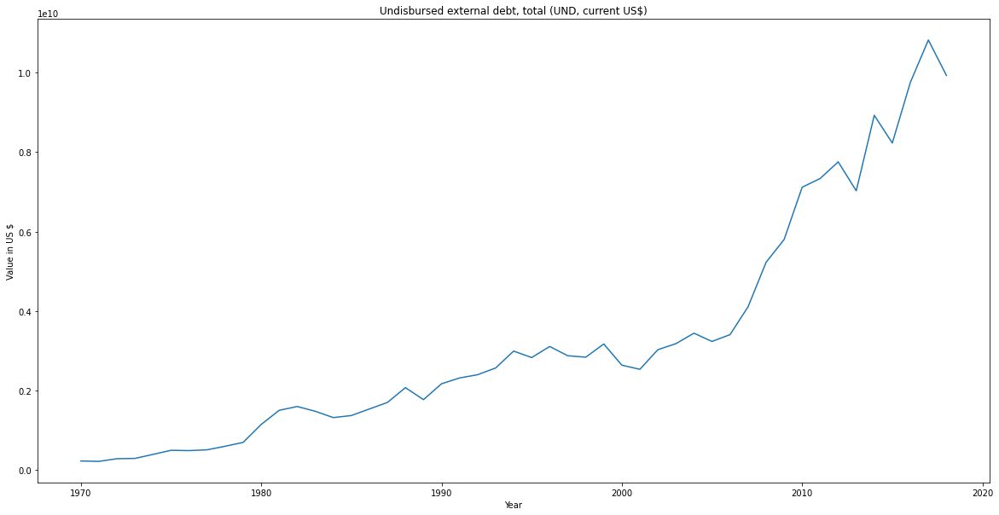

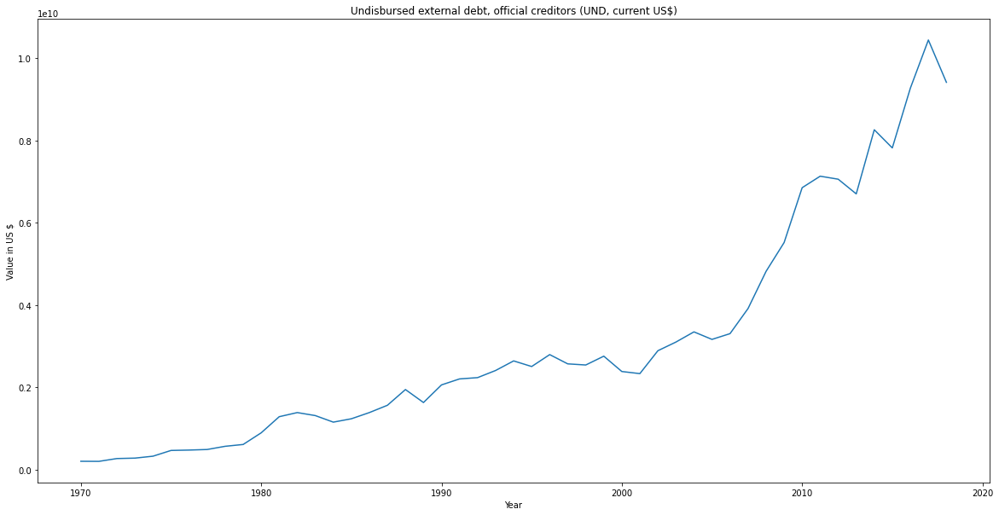

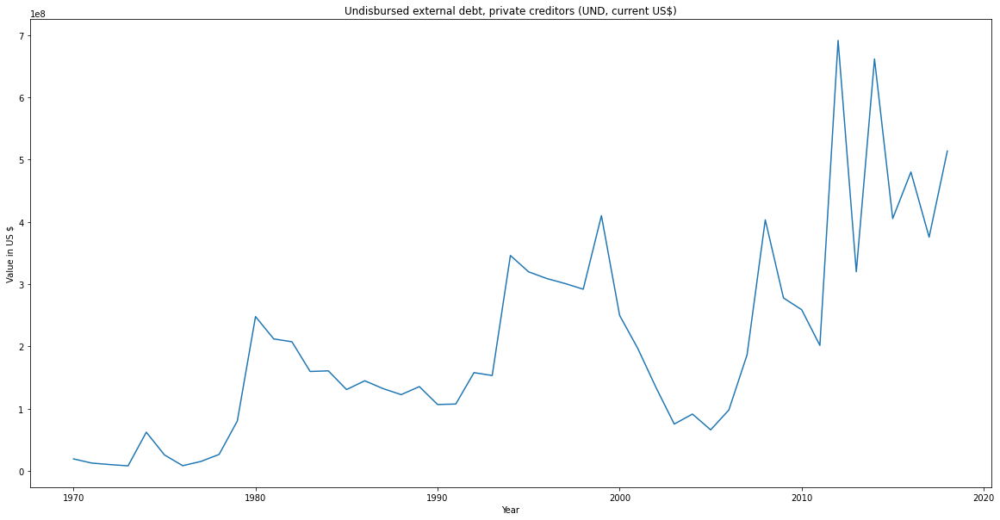

In [4]:
# Read the unique Indicator Codes
IC = df["Indicator Code"].unique()

# Load sub dataframes under each indicator
dfList = []
for item in IC:
#     retrieves sub data frames based on unique indicator codes
    subDf = df[df["Indicator Code"] == item]
    
#     converts the string list to floats, helps to plot the graphs in order
    x = np.array(subDf["Year"].to_list(), dtype=np.float32)
    y = np.array(subDf["Value"].to_list(), dtype=np.float32)

#     plots the graph
    plt.plot(x, y)
    plt.title(subDf['Indicator Name'].iloc[0])
    plt.ylabel("Value in US $")
    plt.xlabel("Year")
    plt.show()

    dfList.append({"df": subDf, "code": subDf["Indicator Code"].iloc[0]})
    
    

#     plots the graph for gdp

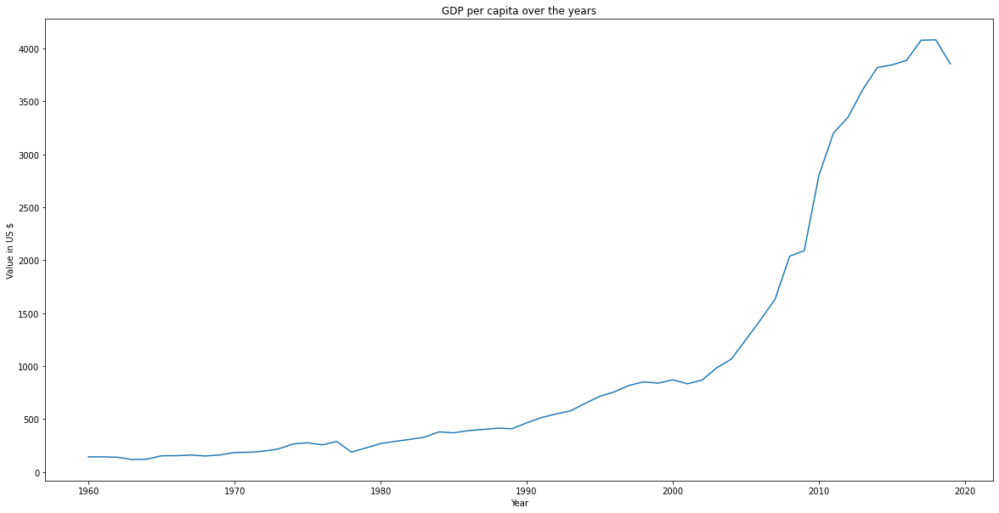

In [5]:
    gdpX = np.array(df2["label"].to_list(), dtype=np.float32)
    gdpY = np.array(df2["GDP Per Capita"].to_list(), dtype=np.float32)
    
    
    plt.plot(gdpX, gdpY)
    plt.title("GDP per capita over the years")
    plt.ylabel("Value in US $")
    plt.xlabel("Year")
    plt.show()

# Debt owed to nonresidents repayable in currency, goods, or services (DOD)

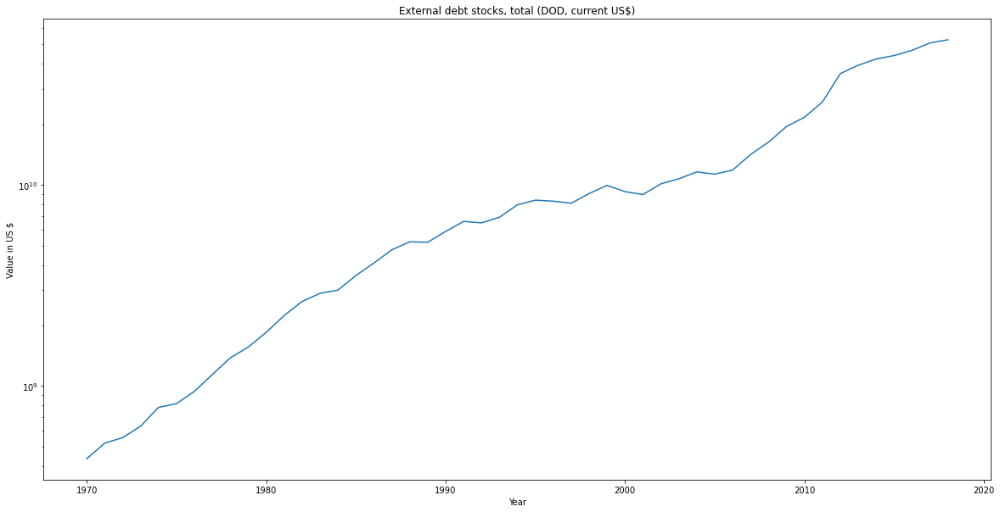

In [6]:

edsDf = pd.DataFrame() 
    
for do in dfList:
    if('DT.DOD.DECT.CD' in do['code']):
        edsDf = do['df']
        break

dodX = np.array(edsDf["Year"].to_list(), dtype=np.float32)
dodY = np.array(edsDf["Value"].to_list(), dtype=np.float32)
    
plt.plot(dodX, dodY)
plt.yscale('log', nonpositive='clip')
plt.title(edsDf['Indicator Name'].iloc[0])
plt.ylabel("Value in US $")
plt.xlabel("Year")
plt.show()
plt.show()

# GDP Vs DOD

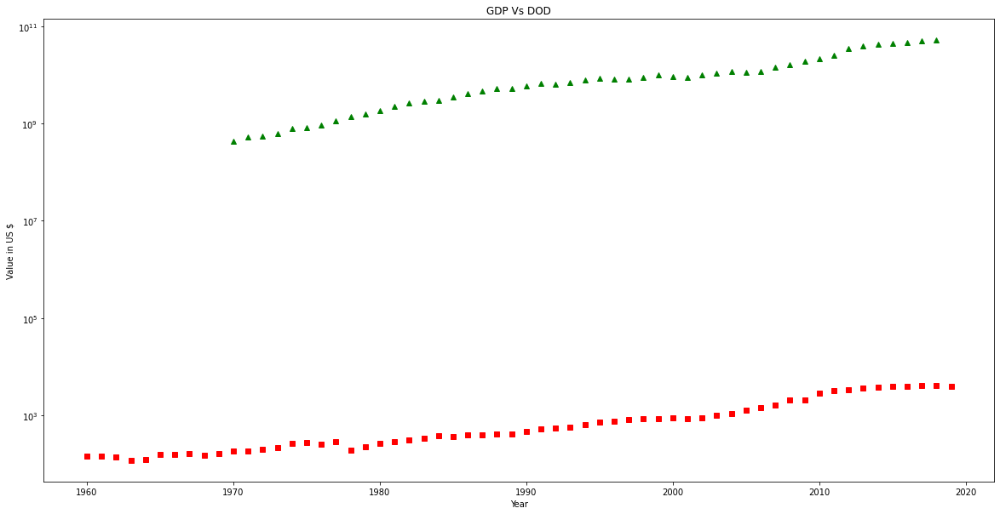

In [7]:
# Both the change in gross domestic product and the debt owed to nonresidents repayable in currency, 
# goods, or services are shown in the following reperesentation. 
# Logscale is used in the yaxis in order to clearly represent the gap between the gdp and the dod.

plt.plot(gdpX, gdpY, 'rs', dodX, dodY, 'g^')
plt.yscale('log', nonpositive='clip')
plt.title("GDP Vs DOD")
plt.ylabel("Value in US $")
plt.xlabel("Year")
plt.show()


# Ratio between the gdp and the dod

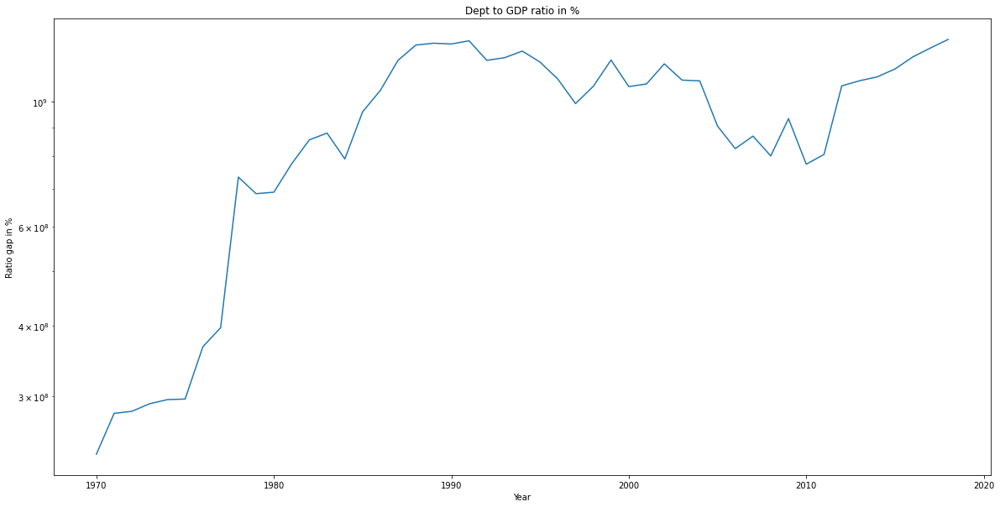

In [8]:
# Formula : Debt-to-GDP Ratio = (Total Debt of Country / Total GDP of Country) × 100

gdpDict = dict (zip (gdpX, gdpY))
dodDict = dict (zip (dodX, dodY))

gdpVsDodRatio = []
for key in dodDict:
    gdpVsDodRatio.append({'year': key, 'ratio': (dodDict[key]/gdpDict[key]) * 100})
    
gdpVsDodRatioDf = pd.DataFrame(gdpVsDodRatio)
plt.plot(gdpVsDodRatioDf['year'], gdpVsDodRatioDf['ratio'])
plt.yscale('log', nonpositive='clip')
plt.title("Dept to GDP ratio in %")
plt.ylabel("Ratio gap in %")
plt.xlabel("Year")
plt.show()




# Moving average calculation

<ipython-input-9-13a67cccfa4a>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  edsDf["MA_5"] = edsDf["Value"].rolling(5).mean()


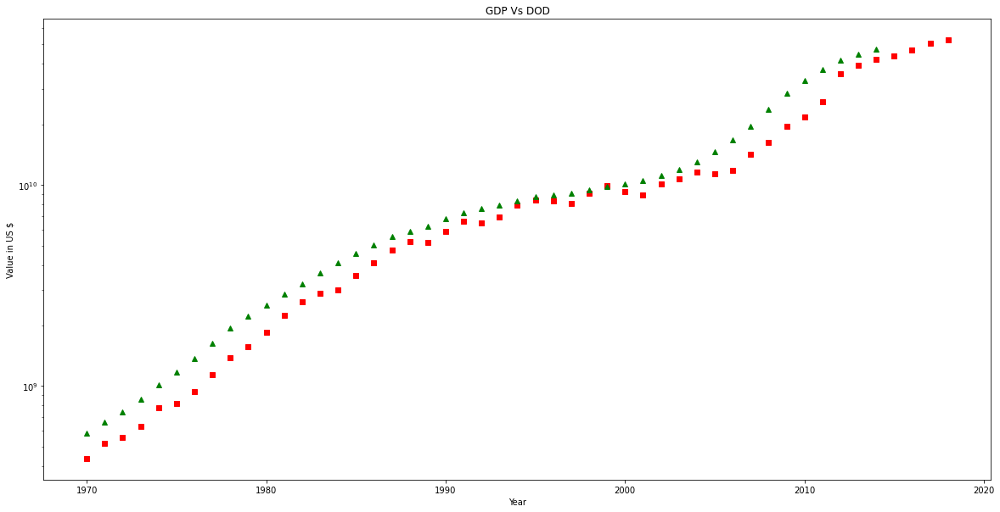

In [9]:
# Calculates the moving average of an interval of five years 

edsDf["MA_5"] = edsDf["Value"].rolling(5).mean()

maX = np.array(edsDf["Year"].to_list(), dtype=np.float32)

plt.plot(dodX, dodY, 'rs', maX, edsDf["MA_5"], 'g^')
plt.yscale('log', nonpositive='clip')
plt.title("GDP Vs DOD")
plt.ylabel("Value in US $")
plt.xlabel("Year")
plt.show()



# Linear Regressional Projection

In [10]:
# Replace the nan values in the generated moving average.
edsDf['MA_5'] = edsDf['MA_5'].replace(np.nan, 0)

# train the linear regression algorithm
reg = linear_model.LinearRegression()
reg.fit(edsDf['Year'].values.reshape(49, 1), edsDf['MA_5'].values.reshape(49, 1))


<ipython-input-10-d3085639c8cc>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  edsDf['MA_5'] = edsDf['MA_5'].replace(np.nan, 0)


LinearRegression()

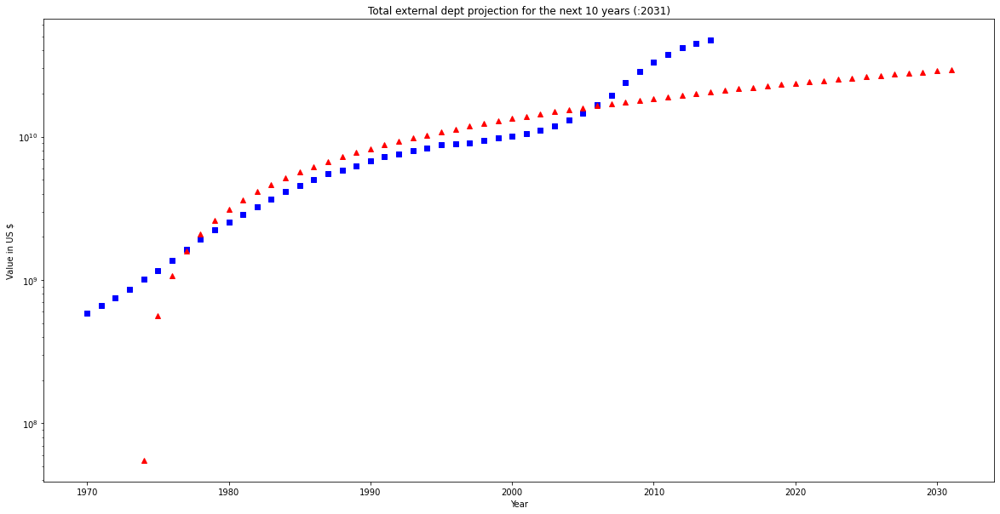

In [11]:
# Copy the colums year and moving average to a new data frame
selected_columns = edsDf[["Year","MA_5"]]
predDf = selected_columns.copy()

# append the new year set to be predicted to the dataframe
predYears = {'Year': [2019, 2020, 2021, 2022, 2023, 2024, 2025, 2026, 2027, 2028, 2029, 2030, 2031]}
predDf = predDf.append(pd.DataFrame(predYears))

predDf['Year'] = predDf['Year'].astype(int)
predDf = predDf.sort_values('Year', ascending=False)

# predict and append the predictions as a new column to the dataframe 
p = reg.predict(predDf[['Year']])
pFlatArray = p.flatten()
predDf['predict'] = pFlatArray

plt.plot(predDf['Year'], predDf["MA_5"], 'bs', predDf['Year'], predDf['predict'], 'r^')
plt.yscale('log', nonpositive='clip')
plt.title("Total external dept projection for the next 10 years (:2031)")
plt.ylabel("Value in US $")
plt.xlabel("Year")
plt.show()

In [12]:
print(predDf)
print(2.917078e+10)

     Year          MA_5       predict
12   2031           NaN  2.917078e+10
11   2030           NaN  2.865997e+10
10   2029           NaN  2.814917e+10
9    2028           NaN  2.763837e+10
8    2027           NaN  2.712757e+10
..    ...           ...           ...
424  1974  1.013330e+09  5.507761e+07
425  1973  8.633111e+08 -4.557241e+08
426  1972  7.458571e+08 -9.665258e+08
427  1971  6.615616e+08 -1.477328e+09
428  1970  5.851291e+08 -1.988129e+09

[62 rows x 3 columns]
29170780000.0
